# **Prerequisites**

In [1]:
!pip install -q diffusers==0.14.0 transformers xformers git+https://github.com/huggingface/accelerate.git

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done


In [2]:
!pip install -q opencv-contrib-python
!pip install -q controlnet_aux

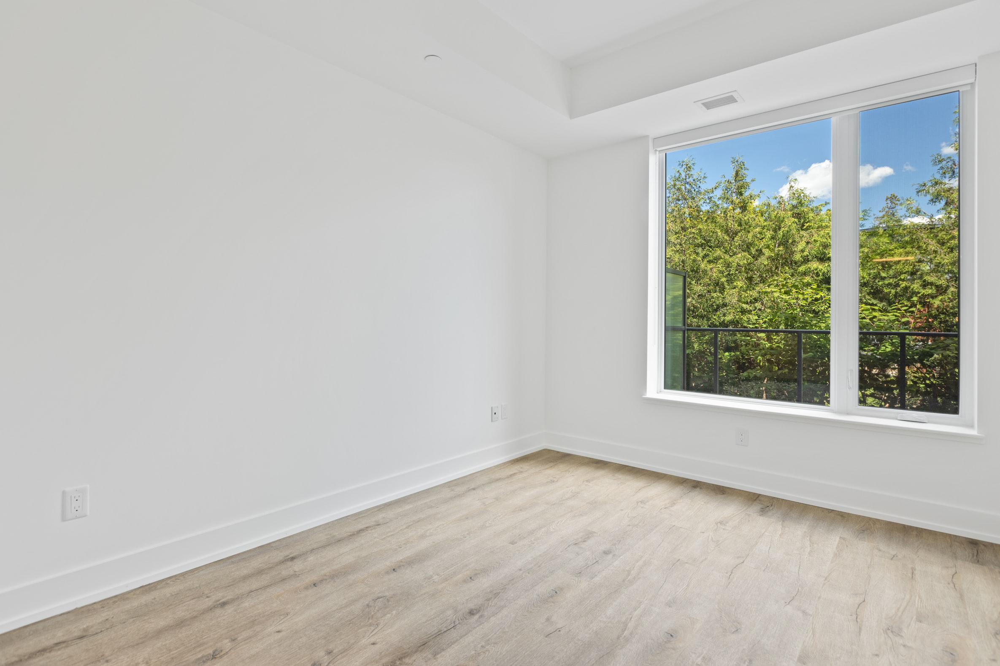

In [51]:
from diffusers import StableDiffusionControlNetPipeline
from diffusers.utils import load_image

image = load_image(
    "https://images.unsplash.com/photo-1630699376059-b781970715b1?ixlib=rb-4.0.3&ixid=MnwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHx8&auto=format&fit=crop&w=2370&q=80"
)
image

Canny pre-processor:

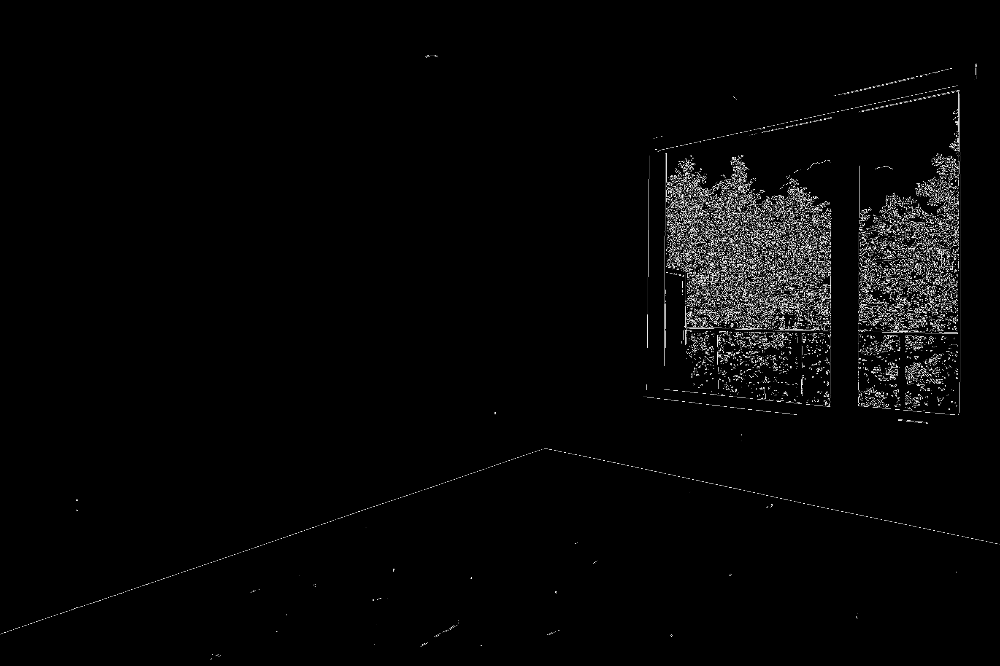

In [52]:
import cv2
from PIL import Image
import numpy as np

image = np.array(image)

low_threshold = 200
high_threshold = 250

image = cv2.Canny(image, low_threshold, high_threshold)
image = image[:, :, None]
image = np.concatenate([image, image, image], axis=2)
canny_image = Image.fromarray(image)
canny_image

In [5]:
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel
import torch

from diffusers import DiffusionPipeline

#runwayml/stable-diffusion-v1-5
# pipe = DiffusionPipeline.from_pretrained("medmac01/beldimoroccaninteriour")

controlnet = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-canny", torch_dtype=torch.float16)
pipe = StableDiffusionControlNetPipeline.from_pretrained(
    "medmac01/beldi-moroccan-interior-2", controlnet=controlnet, torch_dtype=torch.float16
)

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

The config attributes {'addition_embed_type': None, 'addition_embed_type_num_heads': 64, 'class_embeddings_concat': False, 'cross_attention_norm': None, 'encoder_hid_dim': None, 'mid_block_only_cross_attention': None, 'resnet_out_scale_factor': 1.0, 'resnet_skip_time_act': False, 'time_embedding_act_fn': None, 'time_embedding_dim': None} were passed to UNet2DConditionModel, but are not expected and will be ignored. Please verify your config.json configuration file.
/usr/local/lib/python3.10/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(


In [6]:
from diffusers import UniPCMultistepScheduler

pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)

In [7]:
pipe.enable_model_cpu_offload()

In [8]:
pipe.enable_xformers_memory_efficient_attention()

  0%|          | 0/20 [00:00<?, ?it/s]

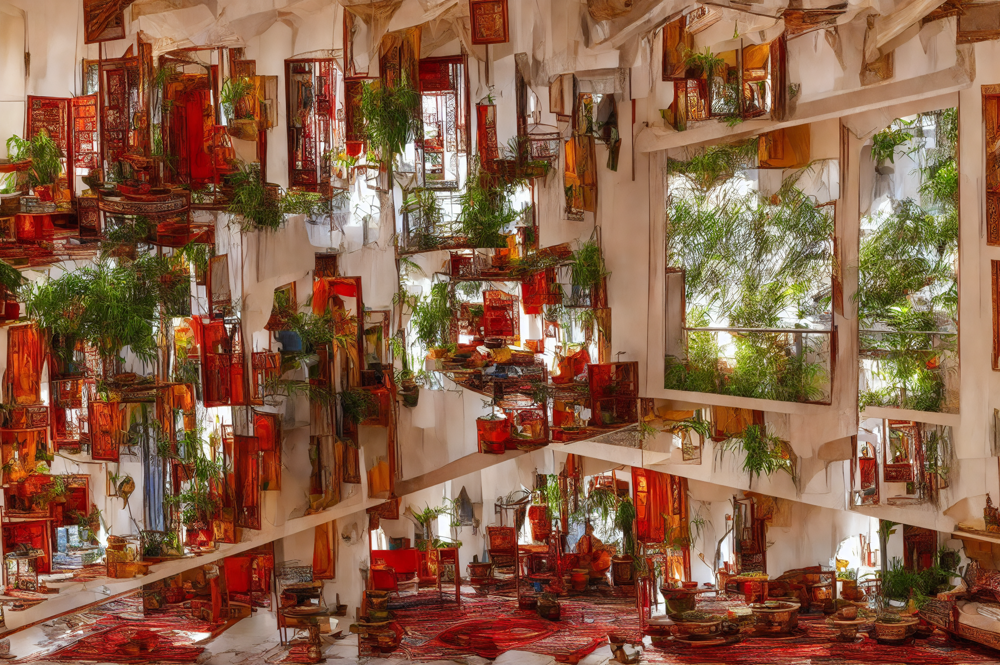

In [54]:
prompt = "beldi moroccan home interior for a living room, minimal"
# prompt = [prompt for t in [""*4]]
# generator = [torch.Generator(device="cpu").manual_seed(2) for i in range(len(prompt))]

output = pipe(
    prompt,
    canny_image,
    negative_prompt="modern design, monochrome, lowres, bad anatomy, worst quality, low quality",
    num_inference_steps=20,
)

output.images[0]

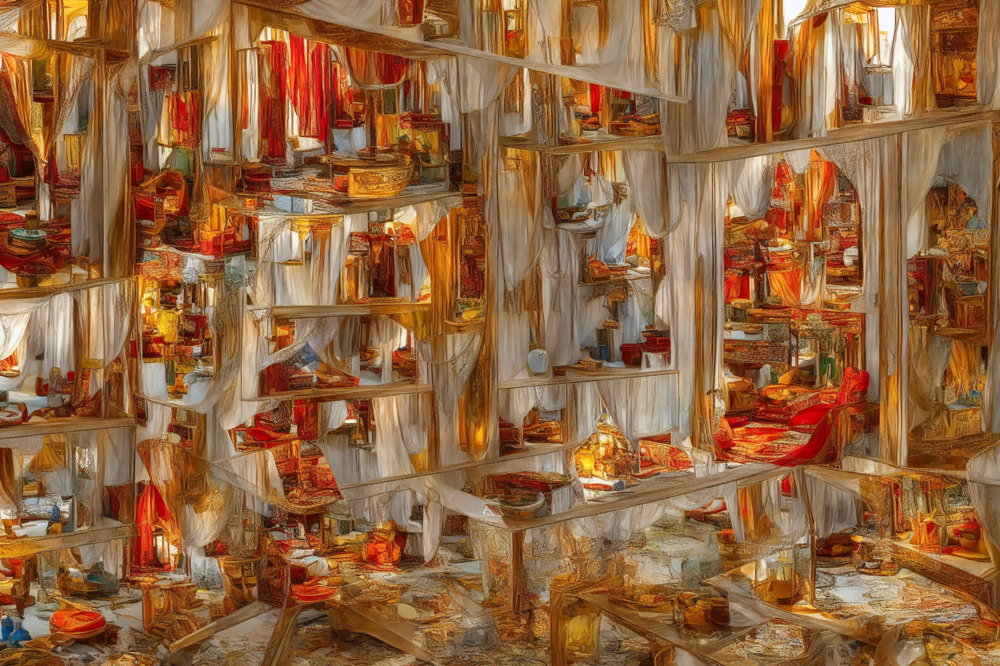

In [33]:
output.images[0]

In [26]:
pipe.save_pretrained("my-ctrlnet")

In [23]:
from huggingface_hub import notebook_login

notebook_login()

In [27]:
# Code to upload a pipeline saved locally to the hub
from huggingface_hub import HfApi, ModelCard, create_repo, get_full_repo_name

# Set up repo and upload files
hub_model_id = 'medmac01/moroccaninteriour-controlNet'
create_repo(hub_model_id)
api = HfApi()
api.upload_folder(folder_path="my-ctrlnet", path_in_repo="", repo_id=hub_model_id)

content = f"""

"""

card = ModelCard(content)
hub_url = card.push_to_hub(hub_model_id)
print(f"Upload successful! Model can be found here: {hub_url}")

diffusion_pytorch_model.bin:   0%|          | 0.00/723M [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/246M [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/608M [00:00<?, ?B/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/1.72G [00:00<?, ?B/s]

Upload 5 LFS files:   0%|          | 0/5 [00:00<?, ?it/s]

diffusion_pytorch_model.bin:   0%|          | 0.00/167M [00:00<?, ?B/s]

Upload successful! Model can be found here: https://huggingface.co/medmac01/moroccaninteriour-controlNet/blob/main/README.md
View your submission on the public leaderboard here: https://huggingface.co/spaces/dreambooth-hackathon/leaderboard
